# **Analysis of the stereotypical evolution of characters over time**

In [8]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import ast
import seaborn as sns
import json
import re
from collections import Counter
import squarify
import plotly.express as px
import plotly.graph_objects as go
from ipywidgets import interact, widgets, Button, HBox, VBox, Output
import time
from IPython.display import display
from itertools import combinations

# 1. Opening and transformation of the necessary databases

In [9]:
# Opening of character file
characters_df = pd.read_csv('data/character.metadata.tsv', sep='\t', header=None)
characters_df.reset_index(drop=True, inplace=True)
# Adding column names after reading the file
characters_df.columns = ['Wikipedia_movie_ID', 'Freebase_Movie_ID', 'Movie_release_date', 'Character_name', 'Actor_date_of_birth', 'Actor_gender', 'Actor_height','Actor_ethnicity', 'Actor_name', 'Actor_age_at_movie_release','Freebase_character/actor_map_ID','Freebase_character_ID','Freebase_actor_ID']
characters_df

,Wikipedia_movie_ID,Freebase_Movie_ID,Movie_release_date,Character_name,Actor_date_of_birth,Actor_gender,Actor_height,Actor_ethnicity,Actor_name,Actor_age_at_movie_release,Freebase_character/actor_map_ID,Freebase_character_ID,Freebase_actor_ID
0,975900,/m/03vyhn,2001-08-24,Akooshay,1958-08-26,F,1.620,NaN,Wanda De Jesus,42.0,/m/0bgchxw,/m/0bgcj3x,/m/03wcfv7
1,975900,/m/03vyhn,2001-08-24,Lieutenant Melanie Ballard,1974-08-15,F,1.780,/m/044038p,Natasha Henstridge,27.0,/m/0jys3m,/m/0bgchn4,/m/0346l4
2,975900,/m/03vyhn,2001-08-24,Desolation Williams,1969-06-15,M,1.727,/m/0x67,Ice Cube,32.0,/m/0jys3g,/m/0bgchn_,/m/01vw26l
3,975900,/m/03vyhn,2001-08-24,Sgt Jericho Butler,1967-09-12,M,1.750,NaN,Jason Statham,33.0,/m/02vchl6,/m/0bgchnq,/m/034hyc
4,975900,/m/03vyhn,2001-08-24,Bashira Kincaid,1977-09-25,F,1.650,NaN,Clea DuVall,23.0,/m/02vbb3r,/m/0bgchp9,/m/01y9xg
...,...,...,...,...,...,...,...,...,...,...,...,...,...
450664,913762,/m/03pcrp,1992-05-21,Elensh,1970-05,F,NaN,NaN,Dorothy Elias-Fahn,NaN,/m/0kr406c,/m/0kr406h,/m/0b_vcv
450665,913762,/m/03pcrp,1992-05-21,Hibiki,1965-04-12,M,NaN,NaN,Jonathan Fahn,27.0,/m/0kr405_,/m/0kr4090,/m/0bx7_j
450666,28308153,/m/0cp05t9,1957,NaN,1941-11-18,M,1.730,/m/02w7gg,David Hemmings,15.0,/m/0g8ngmc,NaN,/m/022g44
450667,28308153,/m/0cp05t9,1957,NaN,NaN,NaN,NaN,NaN,Roberta Paterson,NaN,/m/0g8ngmj,NaN,/m/0g8ngmm


In [10]:
# Opening of movie file
movies_df = pd.read_csv('data/movie.metadata.tsv', sep='\t', header=None)
movies_df.head()

# Adding column names after reading the file
movies_df.columns = ['Wikipedia_movie_ID', 'Freebase_Movie_ID', 'Movie_name', 'Movie_release_date', 'Movie_box_office_revenue', 'Movie_runtime', 'Movie_languages','Movie_countries',
                         'Movie_genres']

movies_df

,Wikipedia_movie_ID,Freebase_Movie_ID,Movie_name,Movie_release_date,Movie_box_office_revenue,Movie_runtime,Movie_languages,Movie_countries,Movie_genres
0,975900,/m/03vyhn,Ghosts of Mars,2001-08-24,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/01jfsb"": ""Thriller"", ""/m/06n90"": ""Science..."
1,3196793,/m/08yl5d,Getting Away with Murder: The JonBenét Ramsey ...,2000-02-16,NaN,95.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/02n4kr"": ""Mystery"", ""/m/03bxz7"": ""Biograp..."
2,28463795,/m/0crgdbh,Brun bitter,1988,NaN,83.0,"{""/m/05f_3"": ""Norwegian Language""}","{""/m/05b4w"": ""Norway""}","{""/m/0lsxr"": ""Crime Fiction"", ""/m/07s9rl0"": ""D..."
3,9363483,/m/0285_cd,White Of The Eye,1987,NaN,110.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}","{""/m/01jfsb"": ""Thriller"", ""/m/0glj9q"": ""Erotic..."
4,261236,/m/01mrr1,A Woman in Flames,1983,NaN,106.0,"{""/m/04306rv"": ""German Language""}","{""/m/0345h"": ""Germany""}","{""/m/07s9rl0"": ""Drama""}"
...,...,...,...,...,...,...,...,...,...
81736,35228177,/m/0j7hxnt,Mermaids: The Body Found,2011-03-19,NaN,120.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/07s9rl0"": ""Drama""}"
81737,34980460,/m/0g4pl34,Knuckle,2011-01-21,NaN,96.0,"{""/m/02h40lc"": ""English Language""}","{""/m/03rt9"": ""Ireland"", ""/m/07ssc"": ""United Ki...","{""/m/03bxz7"": ""Biographical film"", ""/m/07s9rl0..."
81738,9971909,/m/02pygw1,Another Nice Mess,1972-09-22,NaN,66.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/06nbt"": ""Satire"", ""/m/01z4y"": ""Comedy""}"
81739,913762,/m/03pcrp,The Super Dimension Fortress Macross II: Lover...,1992-05-21,NaN,150.0,"{""/m/03_9r"": ""Japanese Language""}","{""/m/03_3d"": ""Japan""}","{""/m/06n90"": ""Science Fiction"", ""/m/0gw5n2f"": ..."


> To make our work easier, we've merged the two dataframes so that all the information we want to use is in the same place.

In [11]:
# Merging of character and movie dataframes (easier to work with)
merged_df = pd.merge(characters_df, movies_df, on=['Wikipedia_movie_ID', 'Freebase_Movie_ID', 'Movie_release_date'])
merged_df

,Wikipedia_movie_ID,Freebase_Movie_ID,Movie_release_date,Character_name,Actor_date_of_birth,Actor_gender,Actor_height,Actor_ethnicity,Actor_name,Actor_age_at_movie_release,Freebase_character/actor_map_ID,Freebase_character_ID,Freebase_actor_ID,Movie_name,Movie_box_office_revenue,Movie_runtime,Movie_languages,Movie_countries,Movie_genres
0,975900,/m/03vyhn,2001-08-24,Akooshay,1958-08-26,F,1.620,NaN,Wanda De Jesus,42.0,/m/0bgchxw,/m/0bgcj3x,/m/03wcfv7,Ghosts of Mars,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/01jfsb"": ""Thriller"", ""/m/06n90"": ""Science..."
1,975900,/m/03vyhn,2001-08-24,Lieutenant Melanie Ballard,1974-08-15,F,1.780,/m/044038p,Natasha Henstridge,27.0,/m/0jys3m,/m/0bgchn4,/m/0346l4,Ghosts of Mars,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/01jfsb"": ""Thriller"", ""/m/06n90"": ""Science..."
2,975900,/m/03vyhn,2001-08-24,Desolation Williams,1969-06-15,M,1.727,/m/0x67,Ice Cube,32.0,/m/0jys3g,/m/0bgchn_,/m/01vw26l,Ghosts of Mars,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/01jfsb"": ""Thriller"", ""/m/06n90"": ""Science..."
3,975900,/m/03vyhn,2001-08-24,Sgt Jericho Butler,1967-09-12,M,1.750,NaN,Jason Statham,33.0,/m/02vchl6,/m/0bgchnq,/m/034hyc,Ghosts of Mars,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/01jfsb"": ""Thriller"", ""/m/06n90"": ""Science..."
4,975900,/m/03vyhn,2001-08-24,Bashira Kincaid,1977-09-25,F,1.650,NaN,Clea DuVall,23.0,/m/02vbb3r,/m/0bgchp9,/m/01y9xg,Ghosts of Mars,14010832.0,98.0,"{""/m/02h40lc"": ""English Language""}","{""/m/09c7w0"": ""United States of America""}","{""/m/01jfsb"": ""Thriller"", ""/m/06n90"": ""Science..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
450664,913762,/m/03pcrp,1992-05-21,Elensh,1970-05,F,NaN,NaN,Dorothy Elias-Fahn,NaN,/m/0kr406c,/m/0kr406h,/m/0b_vcv,The Super Dimension Fortress Macross II: Lover...,NaN,150.0,"{""/m/03_9r"": ""Japanese Language""}","{""/m/03_3d"": ""Japan""}","{""/m/06n90"": ""Science Fiction"", ""/m/0gw5n2f"": ..."
450665,913762,/m/03pcrp,1992-05-21,Hibiki,1965-04-12,M,NaN,NaN,Jonathan Fahn,27.0,/m/0kr405_,/m/0kr4090,/m/0bx7_j,The Super Dimension Fortress Macross II: Lover...,NaN,150.0,"{""/m/03_9r"": ""Japanese Language""}","{""/m/03_3d"": ""Japan""}","{""/m/06n90"": ""Science Fiction"", ""/m/0gw5n2f"": ..."
450666,28308153,/m/0cp05t9,1957,NaN,1941-11-18,M,1.730,/m/02w7gg,David Hemmings,15.0,/m/0g8ngmc,NaN,/m/022g44,Five Clues to Fortune,NaN,129.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}","{""/m/0lsxr"": ""Crime Fiction""}"
450667,28308153,/m/0cp05t9,1957,NaN,NaN,NaN,NaN,NaN,Roberta Paterson,NaN,/m/0g8ngmj,NaN,/m/0g8ngmm,Five Clues to Fortune,NaN,129.0,"{""/m/02h40lc"": ""English Language""}","{""/m/07ssc"": ""United Kingdom""}","{""/m/0lsxr"": ""Crime Fiction""}"


# 2. Separation of the merged dataframe into decade period

> We first need to determine if the number of movie release dates we have in order to correctly treat missing data.

In [12]:
# Conversion of the 'Movie_release_date' column to datetime format
merged_df['Movie_release_date'] = pd.to_datetime(merged_df['Movie_release_date'], errors='coerce')

# Count the number of films without release date
films_without_release_date = merged_df['Movie_release_date'].isna().sum()

# Display the number of films without release date
print(f"Number of movies without release date : {films_without_release_date}, which is {round(films_without_release_date/len(merged_df)*100, 2)}% of the dataset")

# Compter le nombre de films sans genre associé
films_without_genre = merged_df['Movie_genres'].isna().sum()

# Afficher le nombre de films sans genre associé
print(f"Number of movies without genre : {films_without_genre}, which is {round(films_without_genre/len(merged_df)*100, 2)}% of the dataset")

Number of movies without release date : 176797, which is 39.23% of the dataset
Number of movies without genre : 0, which is 0.0% of the dataset


> As 39.23% of the dataset doesn't have a release date, we cannot just discard them. We decide to use the average of the release years of similar films based on the genre givent that all movies in the dataset have a genre or a combination of genre.

In [13]:
def extract_genre(string):
    # The re library allows to extract all words between quotes
    between_quotes = re.findall(r'"(.*?)"', string)
    # Suppressing all words starting with /, as they are not country names
    for word in between_quotes:
        if word[0] == '/':
            between_quotes.remove(word)
    # Returning the list of words between quotes
    return between_quotes

# Creation of a new column called "genre_list" in movies_df to have a list of all genres of a movie
movies_df['genre_list'] = movies_df['Movie_genres'].astype(str).apply(extract_genre)

# Création d'une nouvelle colonne 'genre_list' dans movies_df pour avoir une liste de tous les genres d'un film
movies_df['genre_list'] = movies_df['Movie_genres'].astype(str).apply(extract_genre)
merged_df['genre_list'] = merged_df['Movie_genres'].astype(str).apply(extract_genre)

# Convertir les dates en années entières
merged_df['Movie_release_year'] = merged_df['Movie_release_date'].dt.year

# Calculer la moyenne des années de sortie par genre
mean_release_year_by_genre = merged_df.explode('genre_list').groupby('genre_list')['Movie_release_year'].mean()

# Fonction pour estimer l'année de sortie basée sur les genres (en prenant la moyenne des années de sortie des films ayant les mêmes genres)
def estimate_release_year(row):
    if pd.isna(row['Movie_release_date']):
        genres = row['genre_list']
        mean_years = [mean_release_year_by_genre[genre] for genre in genres if genre in mean_release_year_by_genre]
        if mean_years:
            return sum(mean_years) / len(mean_years)
        else:
            return pd.NA
    else:
        return row['Movie_release_year']

# Estimer l'année de sortie des films
merged_df['Estimated_release_year'] = merged_df.apply(estimate_release_year, axis=1)

# Vérification
films_without_release_date = merged_df['Estimated_release_year'].isna().sum()
print(f"Number of movies without release date : {films_without_release_date}, which is {round(films_without_release_date/len(merged_df)*100, 2)}% of the dataset")

Number of movies without release date : 2879, which is 0.64% of the dataset


> After using the mean release date of movies with similar genres or the mean of the means for genres combination, only 0.64% of the dataset, which corresponds to 2879 movies, still don't have release date, which is acceptable to work with. These movies are probably movies that have a unique genre and no release date, making it impossible to calculate the average.

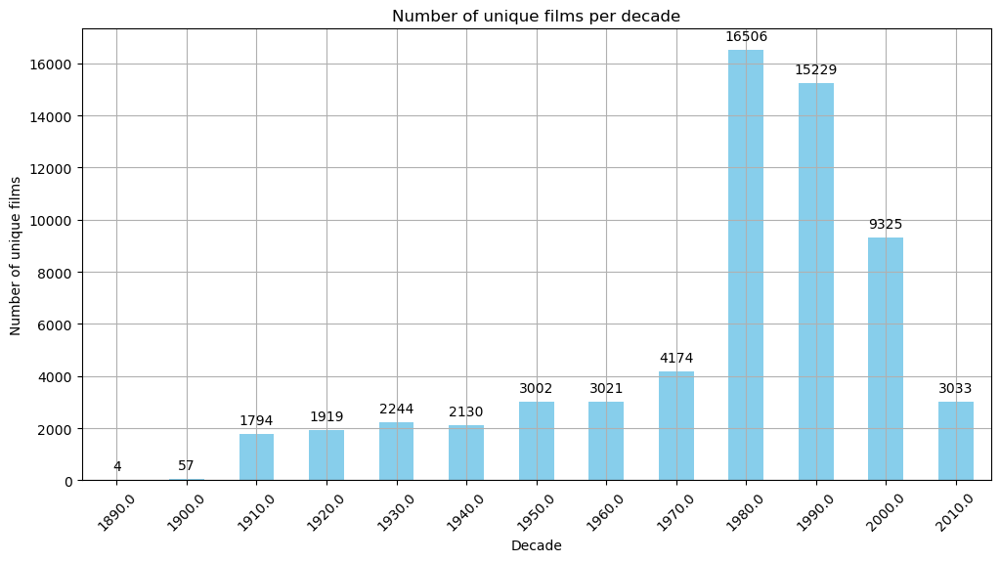

Number of unique movies per decade : 59472


In [14]:
# Creation of a new column 'Decade' to group the movies by decade
merged_df['Decade'] = (merged_df['Estimated_release_year'] // 10) * 10

# Count the number of unique films per decade
unique_films_per_decade = merged_df.groupby('Decade')['Movie_name'].nunique()

# Display the number of unique films per decade
plt.figure(figsize=(12, 6))
ax = unique_films_per_decade.plot(kind='bar', color='skyblue')
plt.title('Number of unique films per decade')
plt.xlabel('Decade')
plt.ylabel('Number of unique films')
plt.xticks(rotation=45)
plt.grid(True)
# Adding the number of films on top of the bars
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
plt.show()

# Counting the number of unique films
total_unique_films = merged_df['Movie_name'].nunique()
# Display the number of unique films
print(f"Number of unique movies per decade : {total_unique_films}")

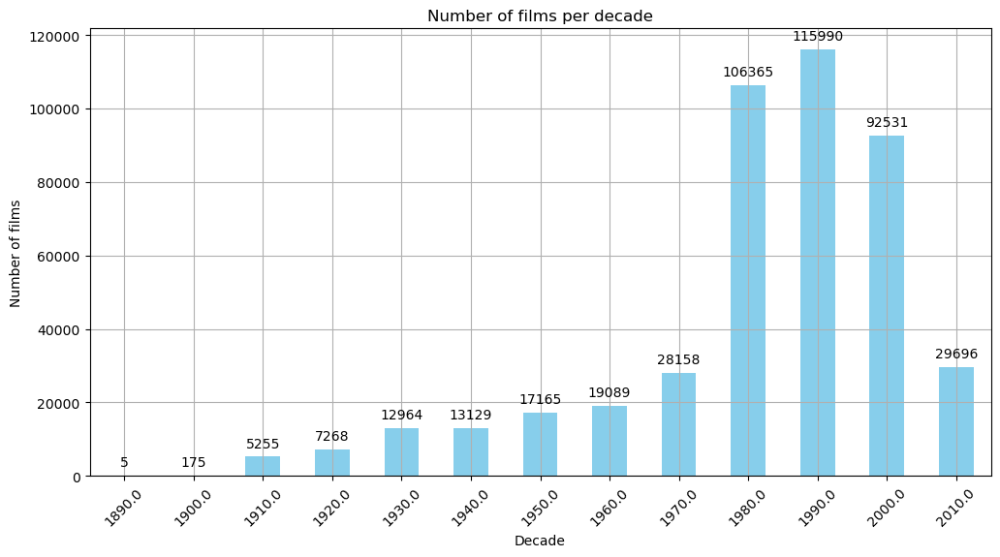

In [15]:
# Compter le nombre de films par décennie
films_per_decade = merged_df['Decade'].value_counts().sort_index()

# Afficher le nombre de films par décennie
plt.figure(figsize=(12, 6))
ax = films_per_decade.plot(kind='bar', color='skyblue')
plt.title('Number of films per decade')
plt.xlabel('Decade')
plt.ylabel('Number of films')
plt.xticks(rotation=45)
plt.grid(True)
# Ajouter le nombre de films au-dessus des barres
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
plt.show()

In [16]:
# Filtrer les films sortis entre 1890 et 1900
# Filtrer les films sortis entre 1890 et 1900
movies_1890s = merged_df[(merged_df['Movie_release_date'] >= '1890-01-01') & (merged_df['Movie_release_date'] < '1900-01-01')]

# Obtenir les noms des films pour cette période
movie_names_1890s = movies_1890s['Movie_name']

# Afficher les noms des films
print(movie_names_1890s)
print(len(movie_names_1890s))

6955      Corbett and Courtney Before the Kinetograph
134019                  The Corbett-Fitzsimmons Fight
219571                            Le Manoir du diable
219572                            Le Manoir du diable
256979                   The Execution of Mary Stuart
Name: Movie_name, dtype: object
5


> As years 1890 and 1900 don't have a lot of movies, we decide to discard them to have significant statistical results.

# 2. Descriptive statistics

> Studying the actor age, gender and ethnicity proportions can lead to interesting findings about steretotypcial character persona evolution.
> - As highlighted in the search results, there's often a significant age gap between actors and the characters they portray, especially for teenage roles. Analyzing actor ages versus character ages can reveal how this practice has evolved and its potential impact on audience perceptions.
> - Tracking gender proportions over time can show how gender representation and roles have changed in films, reflecting broader societal shifts in gender equality and stereotypes.
> - Changes in these proportions often reflect broader societal changes, allowing us to see how cinema both mirrors and influences social norms.
> - Tracking these proportions over time provides historical context for changes in film industry practices and societal attitudes.

## *2.1 Actor ages*

In [17]:
# Count the number of movies without data in Actor_age_at_movie_release
films_without_age = merged_df['Actor_age_at_movie_release'].isna().sum()

# Display the number of movies without data in Actor_age_at_movie_release
print(f"Number of films without data in Actor_age_at_movie_release : {films_without_age} which corresponds to {round(films_without_age/len(merged_df)*100, 2)}% of dataset")

Number of films without data in Actor_age_at_movie_release : 158113 which corresponds to 35.08% of dataset


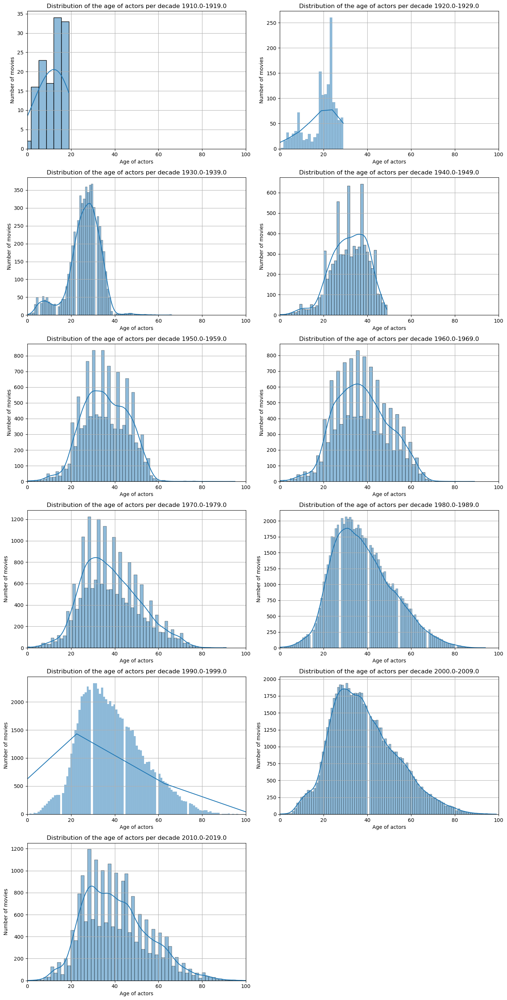

In [18]:
# Obtenir les décennies uniques et filtrer les décennies 1890-1900, 1900-1910 et NaN
decades = merged_df['Decade'].dropna().unique()
decades = [decade for decade in decades if decade not in [1890, 1900]]
# Sort decade by chronological order
decades=sorted(decades)

# Créer une figure avec plusieurs sous-graphiques disposés en deux colonnes
fig, axes = plt.subplots(len(decades) // 2 + len(decades) % 2, 2, figsize=(14, len(decades) * 2.5))

# Tracer la distribution des âges pour chaque décennie
for ax, decade in zip(axes.flatten(), decades):
    sns.histplot(data=merged_df[merged_df['Decade'] == decade], x='Actor_age_at_movie_release', kde=True, ax=ax)
    ax.set_title(f'Distribution of the age of actors per decade {decade}-{decade+9}')
    ax.set_xlabel('Age of actors')
    ax.set_ylabel('Number of movies')
    ax.grid(True)
    ax.set_xlim(0, 100)

# Supprimer les axes vides si le nombre de décennies est impair
if len(decades) % 2 != 0:
    fig.delaxes(axes.flatten()[-1])

# Ajuster la mise en page
plt.tight_layout()
plt.show()

In [19]:
# Filter the movies from the 1910s
movies_1910s = merged_df[(merged_df['Movie_release_date'] >= '1910-01-01') & (merged_df['Movie_release_date'] < '1920-01-01')]

# Obtain the ages of the actors at the release of the movies from the 1910s
actor_ages_1910s = movies_1910s['Actor_age_at_movie_release']

# Count the number of missing values
missing_data_count = actor_ages_1910s.isna().sum()

# Display the number of missing values
print(f"Number of data missing in the colomn Actor_age_at_movie_release for decade 1910-1919 : {missing_data_count}, which is {round(missing_data_count/len(actor_ages_1910s)*100, 2)}% of dataset")

Number of data missing in the colomn Actor_age_at_movie_release for decade 1910-1919 : 5116, which is 97.35% of dataset


> As data for the 1910s are missing, we cannot use the analysis of age for this decade, but we can use it for other even 35.08% of the age value are missing as we have clear histrograms and age distribution.

## *2.2 Gender anaylsis*

In [20]:
# Compter le nombre de films sans donnée dans Actor_age_at_movie_release
movies_without_gender = merged_df['Actor_gender'].isna().sum()

# Afficher le nombre de films sans donnée dans Actor_age_at_movie_release
print(f"Number of movies without data in Movie_gender : {movies_without_gender} which is {round(movies_without_gender/len(merged_df)*100, 2)}% of dataset")

Number of movies without data in Movie_gender : 45609 which is 10.12% of dataset


In [21]:
# Préparer les données pour chaque décennie
decade_gender_counts = merged_df.groupby(['Decade', 'Actor_gender']).size().reset_index(name='count')

# Créer un graphique à barres empilées avec plotly
fig = px.bar(decade_gender_counts, x='Decade', y='count', color='Actor_gender', barmode='stack',
             labels={'count': 'Number of movies', 'Decade': 'Decade', 'Actor_gender': 'Genre'},
             title='Repartition men-women for the decades')

# Afficher le graphique
fig.show()



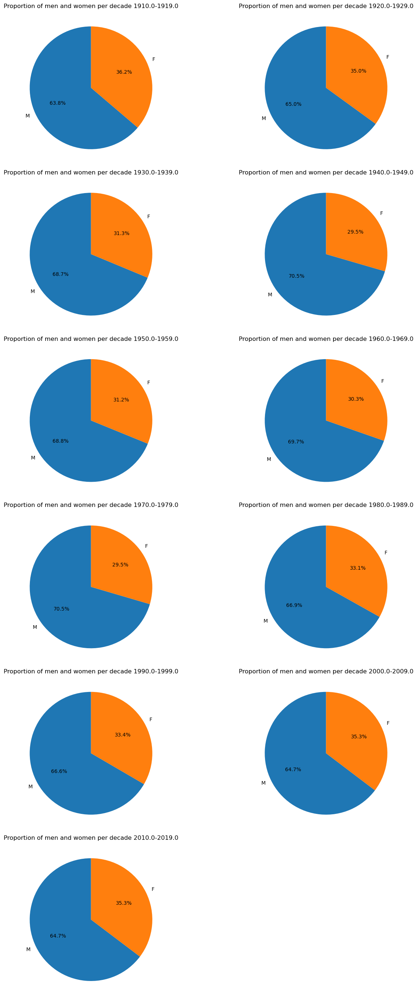

In [22]:
# Sort decade by chronological order
decades=sorted(decades)

# Créer une figure avec plusieurs sous-graphiques disposés en deux colonnes
fig, axes = plt.subplots(len(decades) // 2 + len(decades) % 2, 2, figsize=(14, len(decades) * 2.5))

# Tracer le graphique en fromage pour chaque décennie
for ax, decade in zip(axes.flatten(), decades):
    # Filtrer les données pour la décennie
    data_decade = merged_df[merged_df['Decade'] == decade]
    
    # Compter le nombre d'hommes et de femmes
    gender_counts = data_decade['Actor_gender'].value_counts()
    
    # Tracer le graphique en fromage
    ax.pie(gender_counts, labels=gender_counts.index, autopct='%1.1f%%', startangle=90, colors=['#1f77b4', '#ff7f0e'])
    ax.set_title(f'Proportion of men and women per decade {decade}-{decade+9}')

# Supprimer les axes vides si le nombre de décennies est impair
if len(decades) % 2 != 0:
    fig.delaxes(axes.flatten()[-1])

# Ajuster la mise en page
plt.tight_layout()
plt.show()

In [23]:
# Préparer les données pour chaque décennie
decade_gender_counts = merged_df.groupby(['Decade', 'Actor_gender']).size().reset_index(name='count')

# Créer des frames pour chaque décennie
frames = []
for decade in decade_gender_counts['Decade'].unique():
    frame_data = decade_gender_counts[decade_gender_counts['Decade'] == decade]
    frame = go.Frame(data=[go.Pie(labels=frame_data['Actor_gender'], values=frame_data['count'])],
                     name=str(decade))
    frames.append(frame)

# Créer le graphique initial
initial_data = decade_gender_counts[decade_gender_counts['Decade'] == decade_gender_counts['Decade'].min()]
fig = go.Figure(data=[go.Pie(labels=initial_data['Actor_gender'], values=initial_data['count'])])

# Ajouter les frames au graphique
fig.frames = frames

# Ajouter les boutons de lecture
fig.update_layout(
    title='Proportion of men and women per decade',
    updatemenus=[{
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 1000, 'redraw': True}, 'fromcurrent': True}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }]
)

# Ajouter la timeline
fig.update_layout(
    sliders=[{
        'steps': [
            {
                'args': [[str(decade)], {'frame': {'duration': 300, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 300}}],
                'label': str(decade),
                'method': 'animate'
            } for decade in decade_gender_counts['Decade'].unique()
        ],
        'transition': {'duration': 300},
        'x': 0.1,
        'len': 0.9,
        'xanchor': 'left',
        'y': -0.1,
        'currentvalue': {
            'font': {'size': 20},
            'prefix': 'Decade:',
            'visible': True,
            'xanchor': 'right'
        },
        'tickcolor': 'white'
    }]
)

# Afficher le graphique
fig.show()

> The proportion of actresses does almost not change over the decades.

## *2.3 Etnicity proportion*

In [24]:
# Count the number of movies without data in Actor_age_at_movie_release
actors_without_etnicity = merged_df['Actor_ethnicity'].isna().sum()

# Display the number of movies without data in Actor_age_at_movie_release
print(f"Number of films without data in Actor_age_at_movie_release : {actors_without_etnicity} which corresponds to {round(actors_without_etnicity/len(merged_df)*100, 2)}% of dataset")

Number of films without data in Actor_age_at_movie_release : 344611 which corresponds to 76.47% of dataset


> As 76.47% of the actors don't have a defined ethnicity, we cannot use this information to conduct our study.

# 3. Genre based analysis

> The goal of analyzing genre-based character development is to understand how different genres influence and shape character personas and their evolution over time.
> - Examining how characters develop within specific genres over time can reveal shifts in storytelling trends and societal expectations.
> - Comparing character development across genres can highlight unique aspects of character evolution that might be genre-specific or universal.
> - Analyzing genre-based character development can help identify common stereotypes or tropes associated with specific genres and how these have evolved over time.

## *3.1 Identify genre combinations*

Number of different genres combination : 22507
The 15 most common combinations :
Drama: 6851 films
: 2294 films
Comedy: 2040 films
Documentary: 2001 films
Comedy film: 1387 films
Short Film: 1211 films
Drama, Romance Film: 838 films
Black-and-white: 821 films
Silent film: 779 films
Action: 732 films
Horror: 693 films
Romance Film: 664 films
Black-and-white, Comedy, Indie, Short Film, Silent film: 621 films
Crime Fiction, Drama: 596 films
Documentary, Short Film: 566 films
The combination with 2294 movies is : Unknown


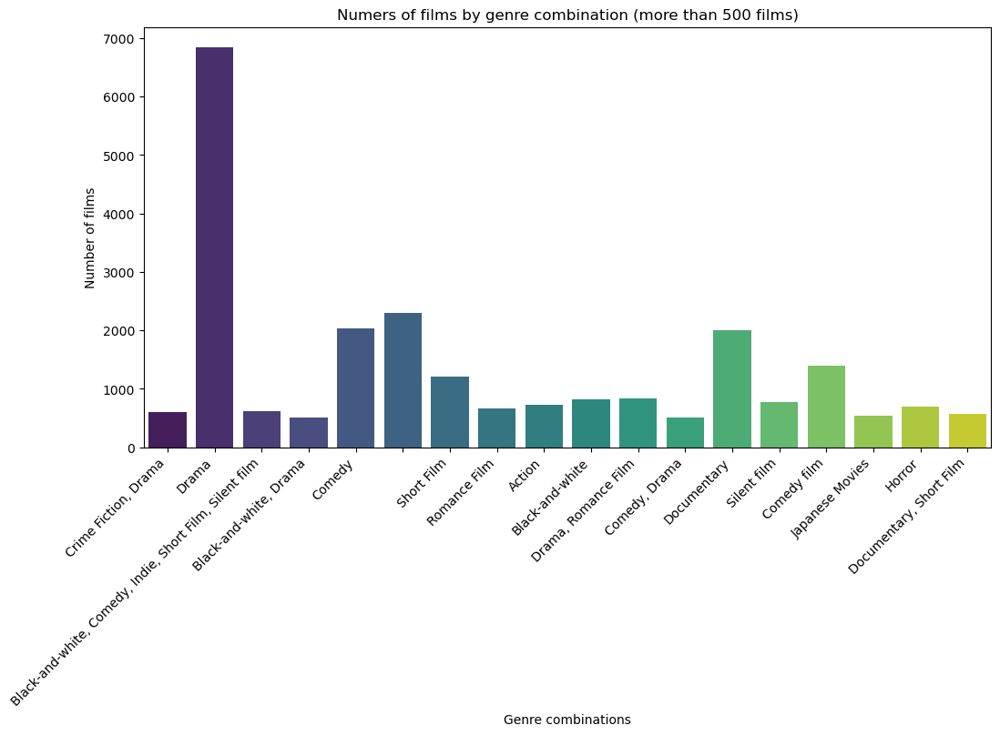

In [25]:
# Function to normalize genres (sort and remove spaces)
# Fonction pour normaliser les genres (par exemple, trier les genres par ordre alphabétique)
def normalize_genres(genres):
    return ', '.join(sorted(genres))

# Create a dictionary to store movies by exact genre combination
movies_by_exact_genres = {}

# Go through the movies and add each movie to the corresponding list in the dictionary
for index, row in movies_df.iterrows():
    normalized_genres = normalize_genres(row['genre_list'])
    if normalized_genres not in movies_by_exact_genres:
        movies_by_exact_genres[normalized_genres] = []
    movies_by_exact_genres[normalized_genres].append(row['Movie_name'])

print(f"Number of different genres combination : {len(movies_by_exact_genres)}")

# Utiliser Counter pour compter les occurrences de chaque combinaison de genres
genre_combinations_counter = Counter({genres: len(titles) for genres, titles in movies_by_exact_genres.items()})

# Find the 10 most common genre combinations
most_common_genre_combinations = genre_combinations_counter.most_common(15)

# Afficher les 10 combinaisons de genres les plus communes
print("The 15 most common combinations :")
for genres, count in most_common_genre_combinations:
    print(f"{genres}: {count} films")

# Vérifier et afficher la combinaison de genres qui a 2294 films
for genres, count in genre_combinations_counter.items():
    if count == 2294:
        print(f"The combination with 2294 movies is : Unknown")

# Filtrer les combinaisons avec plus de 500 films
filtered_genre_combinations = {genres: count for genres, count in genre_combinations_counter.items() if count > 500}

# Tracer les résultats
plt.figure(figsize=(12, 6))
sns.barplot(x=list(filtered_genre_combinations.keys()), y=list(filtered_genre_combinations.values()), palette="viridis", hue=list(filtered_genre_combinations.keys()), legend=False)
plt.title('Numers of films by genre combination (more than 500 films)')
plt.xlabel('Genre combinations')
plt.ylabel('Number of films')
plt.xticks(rotation=45, ha='right')
plt.show()

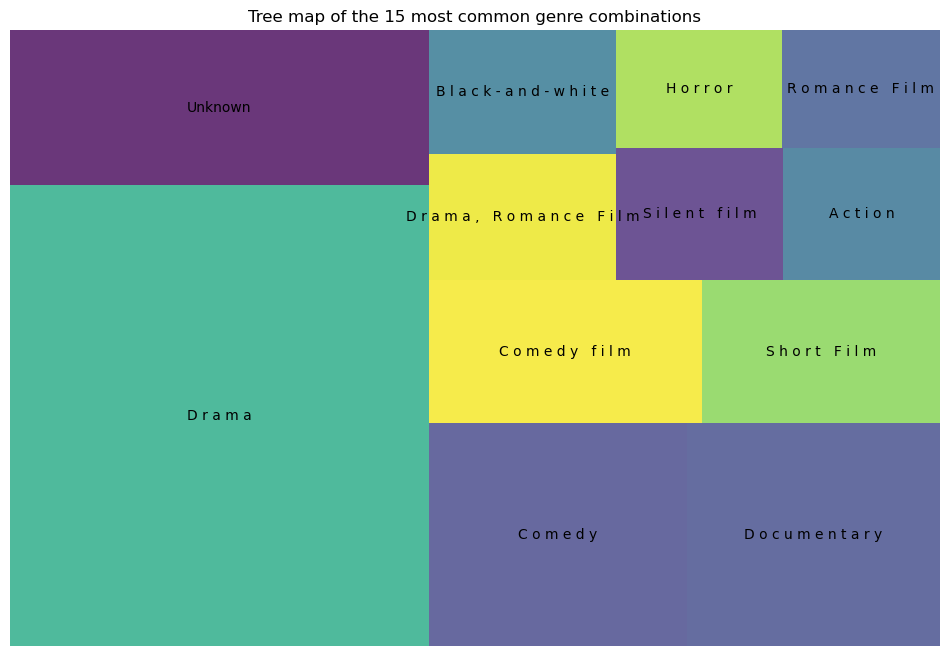

In [26]:

# Utiliser Counter pour compter les occurrences de chaque combinaison de genres
genre_combinations_counter = Counter({genres: len(titles) for genres, titles in movies_by_exact_genres.items()})

# Obtenir les 15 combinaisons de genres les plus fréquentes
top_15_genre_combinations = genre_combinations_counter.most_common(12)

# Préparer les données pour la treemap
labels = [' '.join(genres) if ''.join(genres).strip() else 'Unknown' for genres, count in top_15_genre_combinations]
sizes = [count for genres, count in top_15_genre_combinations]

# Créer la treemap
plt.figure(figsize=(12, 8))
squarify.plot(sizes=sizes, label=labels, alpha=.8)
plt.title('Tree map of the 15 most common genre combinations')
plt.axis('off')
plt.show()

In [37]:
# Liste pour stocker les genres manquants
missing_genres = []

# Fonction pour estimer l'année de sortie basée sur les genres similaires
def estimate_release_year(row):
    if pd.isna(row['Movie_release_date']):
        genres = row['genre_list']
        mean_years = []
        for genre in genres:
            if genre in mean_release_year_by_genre:
                mean_years.append(mean_release_year_by_genre[genre])
            elif genre in similar_genres:
                similar_mean_years = [mean_release_year_by_genre[sim_genre] for sim_genre in similar_genres[genre] if sim_genre in mean_release_year_by_genre]
                if similar_mean_years:
                    mean_years.append(sum(similar_mean_years) / len(similar_mean_years))
                else:
                    missing_genres.append(genre)
            else:
                missing_genres.append(genre)
        if mean_years:
            return sum(mean_years) / len(mean_years)
        else:
            return pd.NA
    else:
        return row['Movie_release_year']

# Estimer l'année de sortie des films
merged_df['Estimated_release_year'] = merged_df.apply(estimate_release_year, axis=1)

# Vérification
films_without_release_date = merged_df['Estimated_release_year'].isna().sum()
print(f"Number of movies without release date : {films_without_release_date}, which is {round(films_without_release_date/len(merged_df)*100, 2)}% of the dataset")

# Compter le nombre de films avec une combinaison de genres unique associée
unique_genre_combinations = movies_df['genre_list'].apply(tuple).nunique()

# Afficher le nombre de films avec une combinaison de genres unique associée
print(f"Number of movies with a unique genre combination : {unique_genre_combinations}")

# Afficher les genres manquants
print("Genres manquants et leurs prédictions basées sur les genres similaires :")
for genre in set(missing_genres):
    print(f"Genre manquant : {genre}")
    if genre in similar_genres:
        similar_mean_years = [mean_release_year_by_genre[sim_genre] for sim_genre in similar_genres[genre] if sim_genre in mean_release_year_by_genre]
        if similar_mean_years:
            predicted_year = sum(similar_mean_years) / len(similar_mean_years)
            print(f"Prédiction basée sur les genres similaires : {predicted_year}")
        else:
            print("Aucune prédiction disponible")
    else:
        print("Aucune prédiction disponible")

Number of movies without release date : 2879, which is 0.64% of the dataset
Number of movies with a unique genre combination : 23817
Genres manquants et leurs prédictions basées sur les genres similaires :


## *3.2 Comparative statistices across decades and genres*

### *3.2.1 Most common genre combination accross decade* 

/tmp/ipykernel_3286/512276301.py:25: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



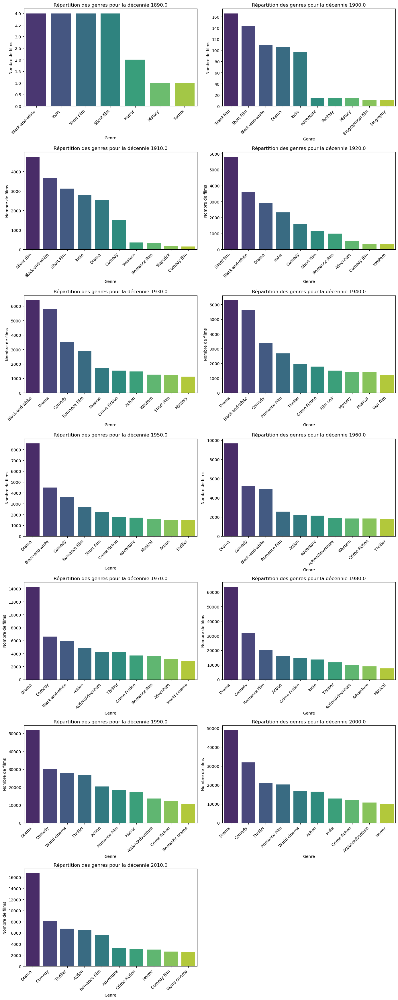

In [27]:
# Function to extract the genre from the string
def extract_genre(string):
    # The re library allows to extract all words between quotes
    between_quotes = re.findall(r'"(.*?)"', string)
    # Suppressing all words starting with /, as they are not country names
    for word in between_quotes:
        if word[0] == '/':
            between_quotes.remove(word)
    # Returning the list of words between quotes
    return between_quotes

# Creation of a new column called "genre_list" in movies_df to have a list of all genres of a movie
merged_df['genre_list'] = merged_df['Movie_genres'].astype(str).apply(extract_genre)

# Combining all genres in a single list
all_genres = [genre for sublist in movies_df['genre_list'] for genre in sublist]

# Exploser la colonne list_genre pour transformer les listes de genres en lignes individuelles
exploded_df = merged_df.explode('genre_list')

# Compter les occurrences de chaque genre par décennie
genre_counts_by_decade = exploded_df.groupby(['Decade', 'genre_list']).size().reset_index(name='count')

# Sélectionner les 10 genres les plus fréquents pour chaque décennie
top_genres_by_decade = genre_counts_by_decade.groupby('Decade').apply(lambda x: x.nlargest(10, 'count')).reset_index(drop=True)

# Obtenir les décennies uniques
decades = top_genres_by_decade['Decade'].unique()

# Calculer le nombre de sous-graphiques nécessaires
num_decades = len(decades)
num_rows = (num_decades + 1) // 2  # Nombre de lignes nécessaires pour deux colonnes


# Créer une figure avec le nombre correct de sous-graphiques
fig, axes = plt.subplots(num_rows, 2, figsize=(14, num_rows * 5))

# Tracer la répartition des genres pour chaque décennie
for ax, decade in zip(axes.flatten(), decades):
    data_decade = top_genres_by_decade[top_genres_by_decade['Decade'] == decade]
    sns.barplot(data=data_decade, x='genre_list', y='count', ax=ax, hue='genre_list', palette='viridis', legend=False)
    ax.set_title(f'Répartition des genres pour la décennie {decade}')
    ax.set_xlabel('Genre')
    ax.set_ylabel('Nombre de films')
    ax.set_xticks(range(len(data_decade['genre_list'])))
    ax.set_xticklabels(data_decade['genre_list'], rotation=45, ha='right')

# Supprimer les axes vides si le nombre de décennies est impair
if num_decades % 2 != 0:
    fig.delaxes(axes.flatten()[-1])

# Ajuster la mise en page
plt.tight_layout()
plt.show()

In [28]:
# Compter les occurrences de chaque genre par décennie
genre_counts_by_decade = exploded_df.groupby(['Decade', 'genre_list']).size().reset_index(name='count')

# Sélectionner les 10 genres les plus fréquents pour chaque décennie
top_genres_by_decade = genre_counts_by_decade.groupby('Decade').apply(lambda x: x.nlargest(10, 'count')).reset_index(drop=True)

# Créer un graphique dynamique avec une timeline
fig = px.bar(top_genres_by_decade, x='genre_list', y='count', color='genre_list', 
             animation_frame='Decade', 
             labels={'count': 'Number of movies', 'genre_list': 'Genre'},
             title='Evolution of the most common genres per decade')

# Ajuster la mise en page
fig.update_layout(
    xaxis_tickangle=-45,
    transition={'duration': 1000000},  # Durée de la transition en millisecondes
)

# Afficher le graphique
fig.show()

/tmp/ipykernel_3286/1225050493.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [33]:
# Compter les occurrences de chaque genre par décennie
genre_counts_by_decade = exploded_df.groupby(['Decade', 'genre_list']).size().reset_index(name='count')

# Sélectionner les 10 genres les plus fréquents pour chaque décennie
top_genres_by_decade = genre_counts_by_decade.groupby('Decade').apply(lambda x: x.nlargest(10, 'count')).reset_index(drop=True)

# Créer un graphique dynamique avec une timeline
fig = px.bar(top_genres_by_decade, x='genre_list', y='count', color='genre_list', 
             animation_frame='Decade', 
             labels={'count': 'Number of movies', 'genre_list': 'Genre'},
             title='Evolution of the most common genres per decade')

# Ajuster la mise en page pour ralentir l'animation
fig.update_layout(
    xaxis_tickangle=-45,
    updatemenus=[{
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 2000, 'redraw': True}, 'fromcurrent': True, 'transition': {'duration': 2000}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }]
)

# Ajouter la timeline
fig.update_layout(
    sliders=[{
        'steps': [
            {
                'args': [[str(decade)], {'frame': {'duration': 2000, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 2000}}],
                'label': str(decade),
                'method': 'animate'
            } for decade in top_genres_by_decade['Decade'].unique()
        ],
        'transition': {'duration': 2000},
        'x': 0.1,
        'len': 0.9,
        'xanchor': 'left',
        'y': -0.1,
        'currentvalue': {
            'font': {'size': 20},
            'prefix': 'Decade:',
            'visible': True,
            'xanchor': 'right'
        },
        'tickcolor': 'white'
    }]
)

# Afficher le graphique
fig.show()

/tmp/ipykernel_3286/1576651523.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### *3.2.2 Probability of co-occurence of genres combinations* 

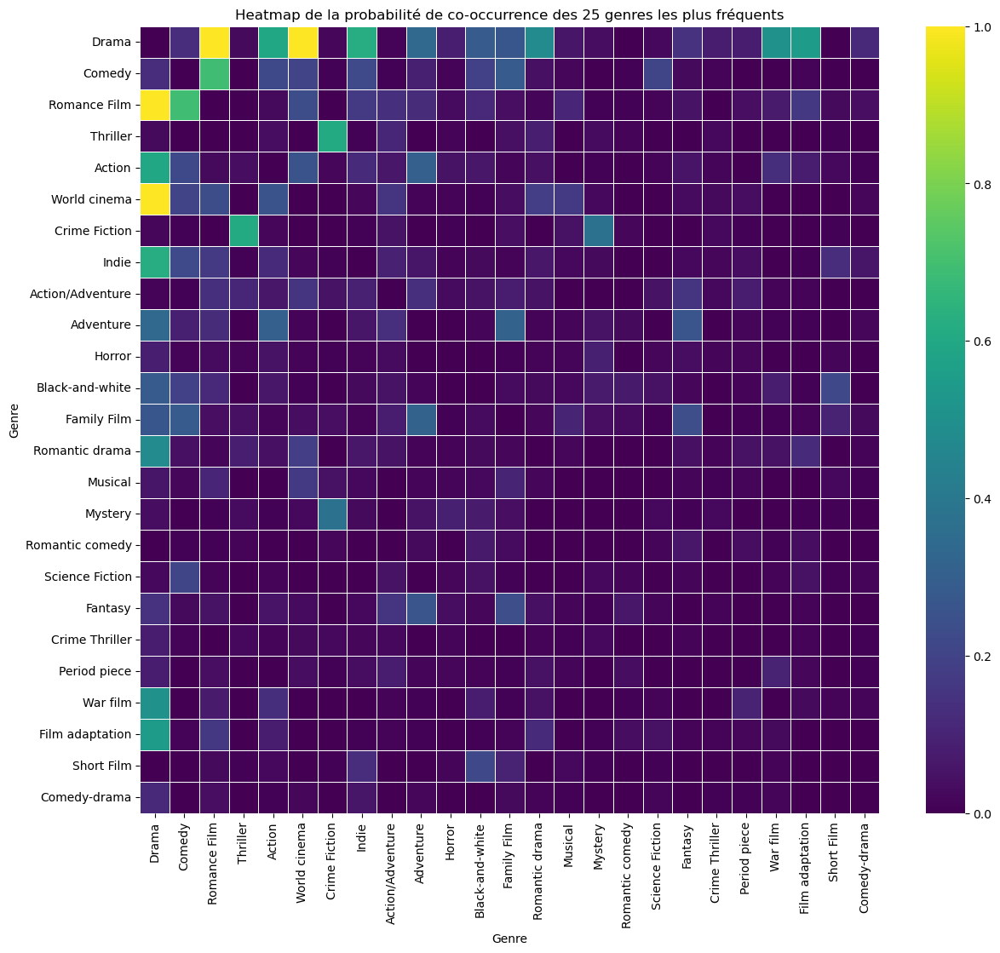

In [71]:
# Calculer les occurrences de chaque genre
all_genres = [genre for sublist in merged_df['genre_list'] for genre in sublist]
genre_counts = Counter(all_genres)

# Sélectionner les 25 genres les plus fréquents
top_25_genres = [genre for genre, count in genre_counts.most_common(25)]

# Filtrer les données pour ne garder que les 25 genres les plus fréquents
filtered_df = merged_df[merged_df['genre_list'].apply(lambda x: any(genre in top_25_genres for genre in x))]

# Calculer les co-occurrences des genres
genre_combinations = []
for genres in filtered_df['genre_list']:
    genre_combinations.extend(combinations([genre for genre in genres if genre in top_25_genres], 2))

# Compter les co-occurrences des genres
co_occurrence_counts = Counter(genre_combinations)

# Créer une DataFrame pour la matrice de co-occurrence
co_occurrence_matrix = pd.DataFrame(0, index=top_25_genres, columns=top_25_genres)

# Remplir la matrice de co-occurrence
for (genre1, genre2), count in co_occurrence_counts.items():
    co_occurrence_matrix.at[genre1, genre2] = count
    co_occurrence_matrix.at[genre2, genre1] = count

# Normaliser les données pour mieux visualiser les co-occurrences
co_occurrence_matrix_normalized = co_occurrence_matrix / co_occurrence_matrix.max().max()

# Créer la heatmap
plt.figure(figsize=(14, 12))
sns.heatmap(co_occurrence_matrix_normalized, annot=False, cmap='viridis', linewidths=.5)
plt.title('Heatmap de la probabilité de co-occurrence des 25 genres les plus fréquents')
plt.xlabel('Genre')
plt.ylabel('Genre')
plt.show()

### *3.2.3 Age reparition and gender repartition per genre or genre combination* 

In [35]:
# Compter les occurrences de chaque genre par décennie
genre_counts_by_decade = exploded_df.groupby(['Decade', 'genre_list']).size().reset_index(name='count')

# Sélectionner les 10 genres les plus fréquents pour chaque décennie
top_genres_by_decade = genre_counts_by_decade.groupby('Decade').apply(lambda x: x.nlargest(10, 'count')).reset_index(drop=True)

# Filtrer les données pour ne garder que les genres les plus fréquents
filtered_df = exploded_df[exploded_df['genre_list'].isin(top_genres_by_decade['genre_list'])]

# Compter les occurrences de chaque genre et genre d'acteur par décennie
gender_genre_counts_by_decade = filtered_df.groupby(['Decade', 'genre_list', 'Actor_gender']).size().reset_index(name='count')

# Créer un graphique dynamique avec une timeline
fig = px.bar(gender_genre_counts_by_decade, x='genre_list', y='count', color='Actor_gender', 
             animation_frame='Decade', 
             labels={'count': 'Nombre de films', 'genre_list': 'Genre', 'Actor_gender': 'Genre de l\'acteur'},
             title='Proportion d\'hommes et de femmes pour les genres les plus communs par décennie')

# Ajuster la mise en page pour ralentir l'animation
fig.update_layout(
    xaxis_tickangle=-45,
    updatemenus=[{
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 2000, 'redraw': True}, 'fromcurrent': True, 'transition': {'duration': 2000}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }]
)

# Ajouter la timeline
fig.update_layout(
    sliders=[{
        'steps': [
            {
                'args': [[str(decade)], {'frame': {'duration': 2000, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 2000}}],
                'label': str(decade),
                'method': 'animate'
            } for decade in gender_genre_counts_by_decade['Decade'].unique()
        ],
        'transition': {'duration': 2000},
        'x': 0.1,
        'len': 0.9,
        'xanchor': 'left',
        'y': -0.1,
        'currentvalue': {
            'font': {'size': 20},
            'prefix': 'Decade:',
            'visible': True,
            'xanchor': 'right'
        },
        'tickcolor': 'white'
    }]
)

# Afficher le graphique
fig.show()

/tmp/ipykernel_3286/4024171307.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [34]:
# Compter les occurrences de chaque genre par décennie
genre_counts_by_decade = exploded_df.groupby(['Decade', 'genre_list']).size().reset_index(name='count')

# Sélectionner les 10 genres les plus fréquents pour chaque décennie
top_genres_by_decade = genre_counts_by_decade.groupby('Decade').apply(lambda x: x.nlargest(10, 'count')).reset_index(drop=True)

# Filtrer les données pour ne garder que les genres les plus fréquents
filtered_df = exploded_df[exploded_df['genre_list'].isin(top_genres_by_decade['genre_list'])]

# Créer un graphique dynamique avec une timeline pour la distribution des âges des acteurs
fig = px.histogram(filtered_df, x='Actor_age_at_movie_release', color='genre_list', 
                   animation_frame='Decade', 
                   labels={'Actor_age_at_movie_release': 'Âge des acteurs', 'genre_list': 'Genre'},
                   title='Distribution des âges des acteurs pour les genres les plus communs par décennie')

# Ajuster la mise en page pour ralentir l'animation
fig.update_layout(
    xaxis_tickangle=-45,
    updatemenus=[{
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 2000, 'redraw': True}, 'fromcurrent': True, 'transition': {'duration': 2000}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }]
)

# Trier les décennies
sorted_decades = sorted(filtered_df['Decade'].unique())

# Ajouter la timeline dans l'ordre chronologique
fig.update_layout(
    sliders=[{
        'steps': [
            {
                'args': [[str(decade)], {'frame': {'duration': 2000, 'redraw': True}, 'mode': 'immediate', 'transition': {'duration': 2000}}],
                'label': str(decade),
                'method': 'animate'
            } for decade in sorted_decades
        ],
        'transition': {'duration': 2000},
        'x': 0.1,
        'len': 0.9,
        'xanchor': 'left',
        'y': -0.1,
        'currentvalue': {
            'font': {'size': 20},
            'prefix': 'Décennie:',
            'visible': True,
            'xanchor': 'right'
        },
        'tickcolor': 'white'
    }]
)

# Afficher le graphique
fig.show()

/tmp/ipykernel_3286/1396553500.py:5: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



## *3.3 Ideas for advanced Analysis*

> - Multi-factor analysis: use tow-way ANOVA to examine interactions between genres and other factors (e.g. release year).
> - Trend analysis: analyze how genre characteristics change over tiem and use regression analysis to idenditfy signficant trends
> - Clustering: apply clustering algorithms (e.g. K-means) to identify natural groupings of genres based on character attributes.